In [97]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
import statsmodels.api as sm
from statsmodels.stats.multicomp import pairwise_tukeyhsd
from sklearn.utils import resample
from math import sqrt


In [6]:
# Example of defining dtypes, adjust these according to your actual data
dtype_dict = {
    'PostalCode': 'category',  # Use category for less frequent values
    'TotalPremium': 'float32',
    'TotalClaims': 'float32',
    # Add other columns as needed
}

chunk_size = 100000  # Adjust based on your memory capacity
data_iterator = pd.read_csv(r"C:\Users\hp\Pictures\AlphaCare Insurance Solutions (ACIS)\alpha-care-risk-analytics\data\processed\insurance_cleaned_dataset.csv", 
                             parse_dates=['TransactionMonth'], 
                             chunksize=chunk_size, 
                             low_memory=False,
                             dtype=dtype_dict)

# Process each chunk
df_list = []
for chunk in data_iterator:
    df_list.append(chunk)

# Combine all chunks into a single DataFrame
df = pd.concat(df_list)
# Quick sanity
print("Rows:", len(df))
print(df.columns)

Rows: 1000098
Index(['UnderwrittenCoverID', 'PolicyID', 'TransactionMonth',
       'IsVATRegistered', 'Citizenship', 'LegalType', 'Title', 'Language',
       'Bank', 'AccountType', 'MaritalStatus', 'Gender', 'Country', 'Province',
       'PostalCode', 'MainCrestaZone', 'SubCrestaZone', 'ItemType', 'mmcode',
       'VehicleType', 'RegistrationYear', 'make', 'Model', 'Cylinders',
       'cubiccapacity', 'kilowatts', 'bodytype', 'NumberOfDoors',
       'VehicleIntroDate', 'CustomValueEstimate', 'AlarmImmobiliser',
       'TrackingDevice', 'CapitalOutstanding', 'NewVehicle', 'WrittenOff',
       'Rebuilt', 'Converted', 'CrossBorder', 'NumberOfVehiclesInFleet',
       'SumInsured', 'TermFrequency', 'CalculatedPremiumPerTerm',
       'ExcessSelected', 'CoverCategory', 'CoverType', 'CoverGroup', 'Section',
       'Product', 'StatutoryClass', 'StatutoryRiskType', 'TotalPremium',
       'TotalClaims', 'NewFeature'],
      dtype='object')


In [57]:
#2. Define KPIs 
# Binary: did policy have at least one claim
df['has_claim'] = (df['TotalClaims'] > 0).astype(int)

# Claim severity: average claim amount conditional on a claim
# We'll compute groupwise statistics later using df_claims
df_claims = df[df['has_claim'] == 1].copy()

# Margin
df['margin'] = df['TotalPremium'] - df['TotalClaims']

# Basic check
print("Overall claim frequency:", df['has_claim'].mean())
print("Overall avg severity (given claim):", df_claims['TotalClaims'].mean())
print("Overall margin (sum):", df['margin'].sum())


Overall claim frequency: 0.002787726802773328
Overall avg severity (given claim): 23273.387
Overall margin (sum): -2.955983e+06


In [59]:
#3. Helper functions 
def print_header(msg):
    print("\n" + "="*6 + " " + msg + " " + "="*6)

def summarize_group_kpis(data, group_col):
    # Returns summary table with counts, freq, severity (conditional), margin mean/median
    groups = data.groupby(group_col).agg(
        policies=('has_claim', 'count'),
        claims_count=('has_claim', 'sum'),
        total_claims_amount=('TotalClaims', 'sum'),
        total_premium=('TotalPremium', 'sum'),
        avg_margin=('margin', 'mean')
    ).reset_index()
    groups['claim_freq'] = groups['claims_count'] / groups['policies']
    # severity: total_claims_amount / claims_count (avoid div by 0)
    groups['claim_severity'] = groups.apply(
        lambda r: (r['total_claims_amount'] / r['claims_count']) if r['claims_count']>0 else np.nan, axis=1)
    groups['loss_ratio'] = groups['total_claims_amount'] / groups['total_premium']
    return groups

def smd_continuous(a, b):
    # standardized mean difference for continuous variables
    return (a.mean() - b.mean()) / np.sqrt((a.var(ddof=1) + b.var(ddof=1)) / 2)

def smd_binary(a, b):
    # smd for binary proportion
    pa = a.mean()
    pb = b.mean()
    pooled = np.sqrt((pa*(1-pa) + pb*(1-pb)) / 2)
    return (pa - pb) / pooled
    print_header("Data Loaded and KPIs Defined")

In [60]:
#4. Hypothesis 1: Differences across provinces 
print_header("H0_1: No risk differences across provinces (frequency/severity)")

prov_summary = summarize_group_kpis(df, 'Province')
print(prov_summary.sort_values('claim_freq', ascending=False).head(10))

# --- 4a: Claim frequency (categorical) across provinces
# Contingency table: province x (claim/no-claim)
ct = pd.crosstab(df['Province'], df['has_claim'])
chi2, p, dof, expected = stats.chi2_contingency(ct)
print(f"Chi-square for claim frequency by province: chi2={chi2:.3f}, p={p:.6f}, dof={dof}")

if p < 0.05:
    print("=> Reject H0 for frequency across provinces (significant differences exist).")
else:
    print("=> Fail to reject H0 for frequency across provinces.")

# --- 4b: Claim severity across provinces (continuous, conditional on claims)
# Use Kruskal-Wallis (nonparametric ANOVA) because severity is typically skewed
groups = [group['TotalClaims'].values for name, group in df_claims.groupby('Province') if len(group)>=10]
group_names = [name for name, group in df_claims.groupby('Province') if len(group)>=10]
if len(groups) >= 2:
    kw_stat, kw_p = stats.kruskal(*groups)
    print(f"Kruskal-Wallis for severity across provinces: H={kw_stat:.3f}, p={kw_p:.6f}")
    if kw_p < 0.05:
        print("=> Reject H0 for severity across provinces (differences exist).")
    else:
        print("=> Fail to reject H0 for severity across provinces.")
else:
    print("Not enough provinces with >= 10 claims to test severity robustly.")

# If Kruskal indicates significance, do pairwise post-hoc (Dunn-like via pairwise Mann-Whitney with Bonferroni)
if len(groups) >= 2 and kw_p < 0.05:
    print("\nPairwise Mann-Whitney U (Bonferroni corrected) for province severity (top pairs):")
    provinces_with_counts = df_claims.groupby('Province').size()
    prov_list = provinces_with_counts[provinces_with_counts >= 10].index.tolist()
    comparisons = []
    for i in range(len(prov_list)):
        for j in range(i+1, len(prov_list)):
            a = df_claims[df_claims['Province']==prov_list[i]]['TotalClaims']
            b = df_claims[df_claims['Province']==prov_list[j]]['TotalClaims']
            stat, pval = stats.mannwhitneyu(a, b, alternative='two-sided')
            comparisons.append((prov_list[i], prov_list[j], stat, pval))
    # apply Bonferroni
    m = len(comparisons)
    for comp in sorted(comparisons, key=lambda x: x[3])[:10]:  # show top 10 lowest p
        i,j,stat,pval = comp
        p_adj = min(pval*m, 1.0)
        print(f"{i} vs {j}: U={stat:.3f}, p={pval:.6f}, p_adj={p_adj:.6f}")




====== H0_1: No risk differences across provinces (frequency/severity) ======
        Province  policies  claims_count  total_claims_amount  total_premium  \
2        Gauteng    393865          1322         2.939415e+07   2.405377e+07   
3  KwaZulu-Natal    169781           483         1.430138e+07   1.320908e+07   
4        Limpopo     24836            67         1.016477e+06   1.537324e+06   
6     North West    143287           349         5.920250e+06   7.490508e+06   
5     Mpumalanga     52718           128         2.044675e+06   2.836292e+06   
8   Western Cape    170796           370         1.038977e+07   9.806558e+06   
0   Eastern Cape     30336            50         1.356427e+06   2.140104e+06   
1     Free State      8099            11         3.549223e+05   5.213632e+05   
7  Northern Cape      6380             8         8.949051e+04   3.165581e+05   

   avg_margin  claim_freq  claim_severity  loss_ratio  
2  -13.558894    0.003356    22234.605144    1.222018  
3   -6.4

In [61]:
#5. Hypothesis 2: Differences between zip codes
print_header("H0_2: No risk differences between zip codes")

# Use PostalCode instead of zipcode
postal_counts = df['PostalCode'].value_counts()
top_postals = postal_counts[postal_counts >= 50].index.tolist()  # threshold can be adjusted
print("Testing on postal codes with >= 50 policies. Count:", len(top_postals))

if len(top_postals) >= 2:
    # Frequency: chi-square across top postals
    ct_postal = pd.crosstab(df[df['PostalCode'].isin(top_postals)]['PostalCode'],
                             df[df['PostalCode'].isin(top_postals)]['has_claim'])
    chi2_postal, p_postal, dof_postal, exp_postal = stats.chi2_contingency(ct_postal)
    print(f"Chi-square for claim frequency by postal code (top postals): chi2={chi2_postal:.3f}, p={p_postal:.6f}")

    if p_postal < 0.05:
        print("=> Reject H0: claim frequency differs between postal codes (among tested postals).")
    else:
        print("=> Fail to reject H0: no evidence of frequency differences among tested postals.")

    # Margin (continuous) across postal codes: use Kruskal-Wallis
    groups_margin = [group['margin'].values for name, group in df[df['PostalCode'].isin(top_postals)].groupby('PostalCode') if len(group)>=50]
    if len(groups_margin) >= 2:
        kw_marg, p_marg = stats.kruskal(*groups_margin)
        print(f"Kruskal-Wallis for margin across postal codes: H={kw_marg:.3f}, p={p_marg:.6f}")
        if p_marg < 0.05:
            print("=> Reject H0: margins differ between postal codes.")
        else:
            print("=> Fail to reject H0: no evidence margins differ between postal codes.")
else:
    print("Not enough postal codes with >= 50 policies to run stable tests.")


====== H0_2: No risk differences between zip codes ======
Testing on postal codes with >= 50 policies. Count: 818
Chi-square for claim frequency by postal code (top postals): chi2=1427.616, p=0.000000
=> Reject H0: claim frequency differs between postal codes (among tested postals).
Kruskal-Wallis for margin across postal codes: H=88162.236, p=0.000000
=> Reject H0: margins differ between postal codes.


In [62]:
#6. Hypothesis 3: Margin difference between zip codes 
# Already covered in H2 as margin test; if required, run pairwise post-hoc Tukey on margin (if approx normal)
print_header("H0_3: No significant margin (profit) difference between zip codes")

# Use ANOVA if groups look approximately normal; otherwise Kruskal-Wallis already used
# Quick normality check for a single large group is not enough; we'll do a pragmatic approach:
if len(top_postals) >= 2:
    # Prepare data for Tukey if assumptions roughly pass (many groups so CLT helps)
    subset = df[df['PostalCode'].isin(top_postals)].copy()
    # If number of groups small and sizes reasonable, run Tukey HSD
    if subset.groupby('PostalCode').size().min() >= 30 and subset.groupby('PostalCode').size().size <= 20:
        # Tukey needs no NaN margin
        tuk = pairwise_tukeyhsd(subset['margin'].dropna(), subset['PostalCode'].loc[subset['margin'].notna()])
        print(tuk.summary())
    else:
        print("Tukey HSD not run due to either too many groups or too small sample per group. Use Kruskal-Wallis pairwise as needed.")


====== H0_3: No significant margin (profit) difference between zip codes ======
Tukey HSD not run due to either too many groups or too small sample per group. Use Kruskal-Wallis pairwise as needed.


In [63]:
print_header("H0_3: No significant margin (profit) difference between postal codes")

# Check if there are at least two postal codes to analyze
if len(top_postals) >= 2:
    # Prepare the subset of data for the postal codes of interest
    subset = df[df['PostalCode'].isin(top_postals)].copy()

    # Ensure there are sufficient samples
    group_sizes = subset.groupby('PostalCode').size()
    
    # Check for conditions for Tukey
    if group_sizes.min() >= 30 and group_sizes.size <= 20:
        # Assuming margin is already calculated
        tuk = pairwise_tukeyhsd(subset['margin'].dropna(), subset['PostalCode'].loc[subset['margin'].notna()])
        print(tuk.summary())
    else:
        print("Tukey HSD not run due to either too many groups or too small sample per group. Using Kruskal-Wallis test.")

        # Perform the Kruskal-Wallis test
        # Create groups for Kruskal-Wallis
        groups_margin = [group['margin'].dropna() for name, group in subset.groupby('PostalCode') if len(group) >= 30]
        
        if len(groups_margin) >= 2:  # Check if there are at least two groups
            kw_marg, p_marg = stats.kruskal(*groups_margin)
            print(f"Kruskal-Wallis for margin across postal codes: H={kw_marg:.3f}, p={p_marg:.6f}")
            
            if p_marg < 0.05:  # Check significance
                print("=> Significant margin differences detected. Performing pairwise comparisons...")
                # Proceed with pairwise testing (e.g., Dunn's test or another method)
                # Here we're using Dunn's test as an example for post-hoc analysis
                from statsmodels.stats.multitest import multipletests

                mc = MultiComparison(subset['margin'].dropna(), subset['PostalCode'].loc[subset['margin'].notna()])
                post_hoc_results = mc.tukeyhsd()
                print(post_hoc_results.summary())
            else:
                print("=> No significant margin differences detected between postal codes.")
        else:
            print("Not enough groups with sufficient data for Kruskal-Wallis.")
else:
    print("Not enough postal codes with sufficient policies to run stable tests.")


====== H0_3: No significant margin (profit) difference between postal codes ======
Tukey HSD not run due to either too many groups or too small sample per group. Using Kruskal-Wallis test.
Kruskal-Wallis for margin across postal codes: H=88162.236, p=0.000000
=> Significant margin differences detected. Performing pairwise comparisons...
    Multiple Comparison of Means - Tukey HSD, FWER=0.05    
group1 group2  meandiff  p-adj    lower      upper   reject
-----------------------------------------------------------
     1   1000    51.9808    1.0   -648.184  752.1456  False
     1   1003    37.4185    1.0   -778.467   853.304  False
     1    101   108.4297    1.0  -811.0404 1027.8998  False
     1   1020    -17.731    1.0  -310.4119  274.9498  False
     1   1021     18.965    1.0  -289.2344  327.1644  False
     1   1022    18.4617    1.0   -194.078  231.0014  False
     1   1023    76.4567    1.0 -1502.9362 1655.8495  False
     1   1024  -142.3556    1.0  -813.6129  528.9016  False


In [65]:
#7. Hypothesis 4: Risk difference between Women and Men 
print_header("H0_4: No significant risk difference between Women and Men")

# Ensure gender categories of interest exist
df['gender_clean'] = df['Gender'].str.lower().str.strip()
gender_counts = df['gender_clean'].value_counts()
print("Gender counts:", gender_counts.to_dict())

# Limit to 'male' and 'female' labels—adjust per your dataset encoding
mask_gender = df['gender_clean'].isin(['male', 'female'])
if mask_gender.sum() == 0:
    print("No standard 'male'/'female' labels found. Inspect gender column manually.")
else:
    gender_df = df[mask_gender].copy()
    # Frequency test: proportion of policies with claims
    ct_gender = pd.crosstab(gender_df['gender_clean'], gender_df['has_claim'])
    chi2_g, p_g, dof_g, exp_g = stats.chi2_contingency(ct_gender)
    print(f"Chi-square for claim frequency by gender: chi2={chi2_g:.3f}, p={p_g:.6f}")
    if p_g < 0.05:
        print("=> Reject H0 for claim frequency between genders.")
    else:
        print("=> Fail to reject H0 for claim frequency between genders.")

    # Severity: compare totalclaims among claimants by gender using Mann-Whitney U (robust)
    a = gender_df[(gender_df['gender_clean']=='male') & (gender_df['has_claim']==1)]['TotalClaims']
    b = gender_df[(gender_df['gender_clean']=='female') & (gender_df['has_claim']==1)]['TotalClaims']
    if len(a) >= 10 and len(b) >= 10:
        stat_g, pval_g = stats.mannwhitneyu(a, b, alternative='two-sided')
        print(f"Mann-Whitney U for severity by gender: U={stat_g:.3f}, p={pval_g:.6f}")
        if pval_g < 0.05:
            print("=> Reject H0 for severity differences between genders.")
        else:
            print("=> Fail to reject H0 for severity differences between genders.")
    else:
        print("Not enough claimants in one of the gender groups for robust severity test.")



====== H0_4: No significant risk difference between Women and Men ======
Gender counts: {'not specified': 940990, 'male': 42817, 'female': 6755}
Chi-square for claim frequency by gender: chi2=0.004, p=0.951464
=> Fail to reject H0 for claim frequency between genders.
Mann-Whitney U for severity by gender: U=524.500, p=0.223513
=> Fail to reject H0 for severity differences between genders.


In [83]:
#8. Data Segmentation for A/B style tests (example) 
print_header("Data Segmentation + Balance checks (example feature: vehiclemake)")

# Example: create Group A (Make != TOYOTA) vs Group B (Make == TOYOTA)
# Replace 'TOYOTA' with any feature category you want to test 
feature = 'make'
value = 'TOYOTA'  # ensure case matches cleaned values: we title-cased earlier
df['groupA'] = (df[feature] != value)
df['groupB'] = (df[feature] == value)

# Create test/control DataFrame: only those two groups
  # adjust as needed
ab_df = df[df[feature].notna()]  # simpler: all rows, groups indicated by boolean

A = df[df[feature] != value]
B = df[df[feature] == value]

print("A size:", len(A), "B size:", len(B))

# Balance check on age-like or other numeric covariates — here example with 'customvalueestimate'
# Compute standardized mean difference
if len(A) > 0 and len(B) > 0:
    smd_cve = smd_continuous(A['CustomValueEstimate'].fillna(0), B['CustomValueEstimate'].fillna(0))
    smd_claimfreq = smd_binary(A['has_claim'], B['has_claim'])
    print("SMD custom value estimate (A vs B):", round(smd_cve,3))
    print("SMD claimfreq (A vs B):", round(smd_claimfreq,3))
    print("Rule of thumb: |SMD| < 0.1 suggests good balance, <0.2 acceptable, >0.2 concerning.")
else:
    print("One of the groups is empty — cannot check balance.")


====== Data Segmentation + Balance checks (example feature: vehiclemake) ======
A size: 186818 B size: 813280
SMD custom value estimate (A vs B): -0.001
SMD claimfreq (A vs B): -0.006
Rule of thumb: |SMD| < 0.1 suggests good balance, <0.2 acceptable, >0.2 concerning.


In [78]:
df["make"].value_counts().head(20)


make
TOYOTA                                 813280
MERCEDES-BENZ                           41940
CMC                                     21624
VOLKSWAGEN                              20929
C.A.M                                   16171
GOLDEN JOURNEY                          14462
NISSAN/DATSUN                           10997
JINBEI                                  10374
IVECO                                    8430
AUDI                                     7407
NISSAN                                   5462
BMW                                      5317
FOTON                                    3482
MERCEDES-BENZ                            3131
HYUNDAI                                  2602
B.A.W                                    2160
HUMMER                                   1194
TOYOTA                                   1166
FIAT                                      984
POLARSUN                                  934
Name: count, dtype: int64

In [76]:
print(df.columns)

Index(['UnderwrittenCoverID', 'PolicyID', 'TransactionMonth',
       'IsVATRegistered', 'Citizenship', 'LegalType', 'Title', 'Language',
       'Bank', 'AccountType', 'MaritalStatus', 'Gender', 'Country', 'Province',
       'PostalCode', 'MainCrestaZone', 'SubCrestaZone', 'ItemType', 'mmcode',
       'VehicleType', 'RegistrationYear', 'make', 'Model', 'Cylinders',
       'cubiccapacity', 'kilowatts', 'bodytype', 'NumberOfDoors',
       'VehicleIntroDate', 'CustomValueEstimate', 'AlarmImmobiliser',
       'TrackingDevice', 'CapitalOutstanding', 'NewVehicle', 'WrittenOff',
       'Rebuilt', 'Converted', 'CrossBorder', 'NumberOfVehiclesInFleet',
       'SumInsured', 'TermFrequency', 'CalculatedPremiumPerTerm',
       'ExcessSelected', 'CoverCategory', 'CoverType', 'CoverGroup', 'Section',
       'Product', 'StatutoryClass', 'StatutoryRiskType', 'TotalPremium',
       'TotalClaims', 'NewFeature', 'has_claim', 'margin', 'gender_clean',
       'groupA', 'groupB'],
      dtype='object')


In [84]:
#9. Formal A/B hypothesis test 
print_header("A/B Tests (examples)")

# 9a: Proportion z-test for claim frequency between A and B
from statsmodels.stats.proportion import proportions_ztest

count = np.array([B['has_claim'].sum(), A['has_claim'].sum()])
nobs = np.array([len(B), len(A)])
stat, pval = proportions_ztest(count, nobs, alternative='two-sided')
print(f"Proportion z-test (B vs A) claim-frequency: z={stat:.3f}, p={pval:.6f}")
if pval < 0.05:
    print("=> Reject null: claim frequency differs between groups.")
else:
    print("=> Fail to reject null: no evidence of difference in claim frequency.")

# 9b: Severity (conditional on claim) - compare mean severity between A and B using bootstrapped CI or Mann-Whitney
a_sev = A[A['has_claim']==1]['TotalClaims']
b_sev = B[B['has_claim']==1]['TotalClaims']

# If sample sizes reasonable, use Mann-Whitney:
if len(a_sev) >= 10 and len(b_sev) >= 10:
    stat_mw, p_mw = stats.mannwhitneyu(a_sev, b_sev, alternative='two-sided')
    print(f"Mann-Whitney for severity A vs B: U={stat_mw:.3f}, p={p_mw:.6f}")
else:
    print("Not enough claimants in groups for Mann-Whitney severity test; consider bootstrapping.")

# Bootstrap mean difference (robust)
def bootstrap_mean_diff(x, y, n_boot=5000, seed=42):
    rng = np.random.RandomState(seed)
    diffs = []
    x = x.dropna().values
    y = y.dropna().values
    for _ in range(n_boot):
        xs = rng.choice(x, size=len(x), replace=True) if len(x)>0 else np.array([0])
        ys = rng.choice(y, size=len(y), replace=True) if len(y)>0 else np.array([0])
        diffs.append(xs.mean() - ys.mean())
    diffs = np.array(diffs)
    return diffs.mean(), np.percentile(diffs, [2.5, 97.5])

if len(a_sev) >= 5 and len(b_sev) >= 5:
    mean_diff, ci = bootstrap_mean_diff(b_sev, a_sev, n_boot=2000)
    print(f"Bootstrap mean severity difference (B - A): {mean_diff:.2f}, 95% CI: [{ci[0]:.2f}, {ci[1]:.2f}]")
    if ci[0] > 0 or ci[1] < 0:
        print("=> 95% CI excludes 0: evidence of difference in mean severity.")
    else:
        print("=> 95% CI includes 0: no strong evidence of difference in mean severity.")
else:
    print("Not enough claimants for bootstrap (need >=5 per group).")


====== A/B Tests (examples) ======
Proportion z-test (B vs A) claim-frequency: z=2.472, p=0.013443
=> Reject null: claim frequency differs between groups.
Mann-Whitney for severity A vs B: U=564377.000, p=0.216573
Bootstrap mean severity difference (B - A): -5663.96, 95% CI: [-10955.77, -1006.82]
=> 95% CI excludes 0: evidence of difference in mean severity.



====== Saving outputs ======


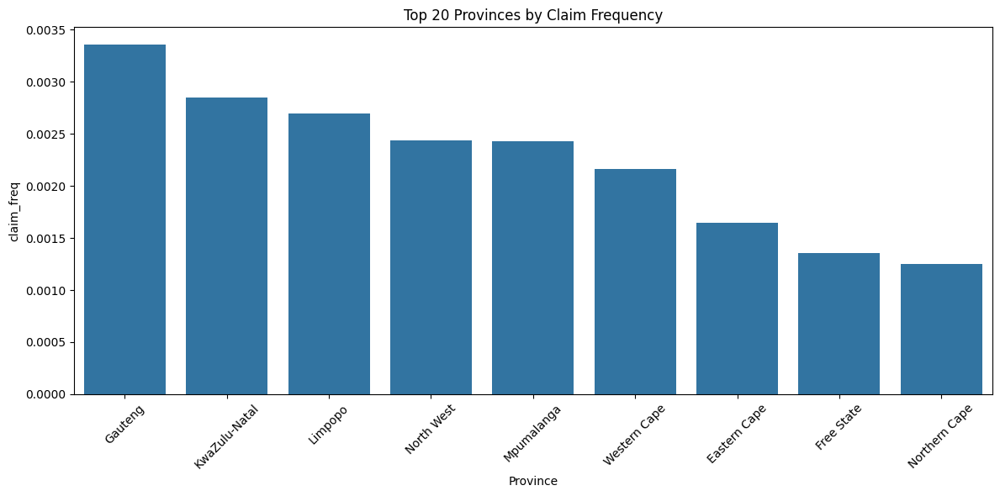

In [93]:
print_header("Saving outputs")

# Summaries
prov_summary.to_csv(r"C:\Users\hp\Pictures\AlphaCare Insurance Solutions (ACIS)\alpha-care-risk-analytics\data\processed\summary_by_province_task3.csv", index=False)

# Ensure zip_counts is defined
if 'zip_counts' in locals():  # Check if zip_counts has been defined
    zip_counts.to_csv("postals_counts.csv", index=False)

# Save final cleaned df with KPIs
df.to_csv(r"C:\Users\hp\Pictures\AlphaCare Insurance Solutions (ACIS)\alpha-care-risk-analytics\data\processed\insurance_cleaned_dataset_with_kpis.csv", index=False)

# Example plots
plt.figure(figsize=(12, 6))
prov_summary_sorted = prov_summary.sort_values('claim_freq', ascending=False).head(20)
sns.barplot(data=prov_summary_sorted, x='Province', y='claim_freq')
plt.xticks(rotation=45)
plt.title("Top 20 Provinces by Claim Frequency")
plt.tight_layout()
plt.savefig(r"C:\Users\hp\Pictures\AlphaCare Insurance Solutions (ACIS)\alpha-care-risk-analytics\output\top20_provinces_claim_freq.png", dpi=150)

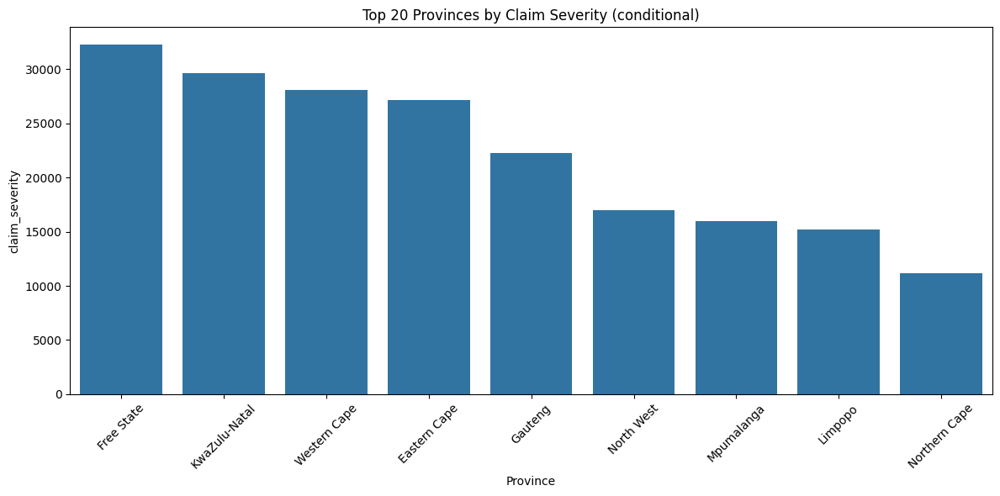

In [96]:
plt.figure(figsize=(12,6))
prov_summary_sorted = prov_summary.sort_values('claim_severity', ascending=False).head(20)
sns.barplot(data=prov_summary_sorted, x='Province', y='claim_severity')
plt.xticks(rotation=45)
plt.title("Top 20 Provinces by Claim Severity (conditional)")
plt.tight_layout()
plt.savefig(r"C:\Users\hp\Pictures\AlphaCare Insurance Solutions (ACIS)\alpha-care-risk-analytics\output\top20_provinces_claim_severity.png", dpi=150)

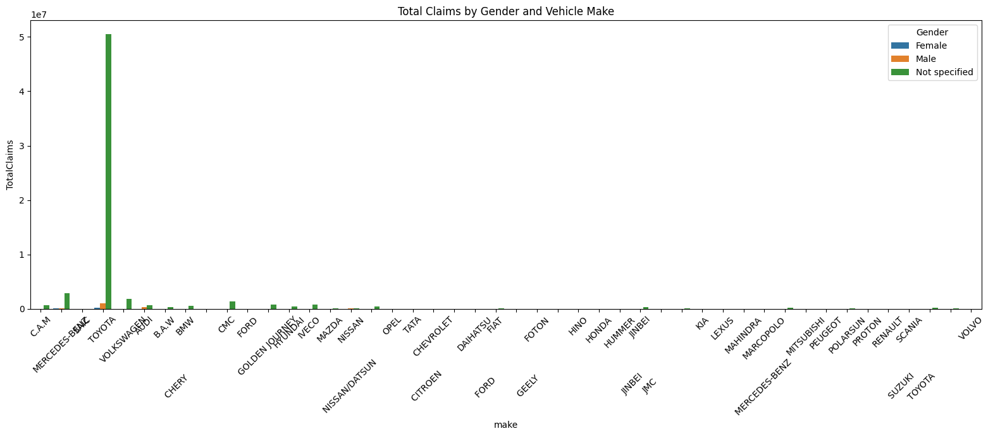

In [102]:
import matplotlib.pyplot as plt
import seaborn as sns

# Identify correct column names
gender_col = 'Gender'
make_col = None

for col in df.columns:
    if col.lower() in ['make', 'vehiclemake', 'vehicle_make']:
        make_col = col
        break

if make_col is None:
    raise ValueError("Vehicle make column not found.")

# Create grouped dataset
gender_make = (
    df.groupby([gender_col, make_col])['TotalClaims']
      .sum()
      .reset_index()
)

plt.figure(figsize=(16,7))

sns.barplot(
    data=gender_make,
    x=make_col,
    y='TotalClaims',
    hue=gender_col
)

plt.title("Total Claims by Gender and Vehicle Make")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [103]:
df_clean = (
    df.copy()
      .drop_duplicates()
      .dropna(subset=['TotalClaims', 'TotalPremium'])   # keep financially valid rows
)

# fix invalid values
df_clean = df_clean[df_clean['TotalClaims'] >= 0]
df_clean = df_clean[df_clean['TotalPremium'] >= 0]


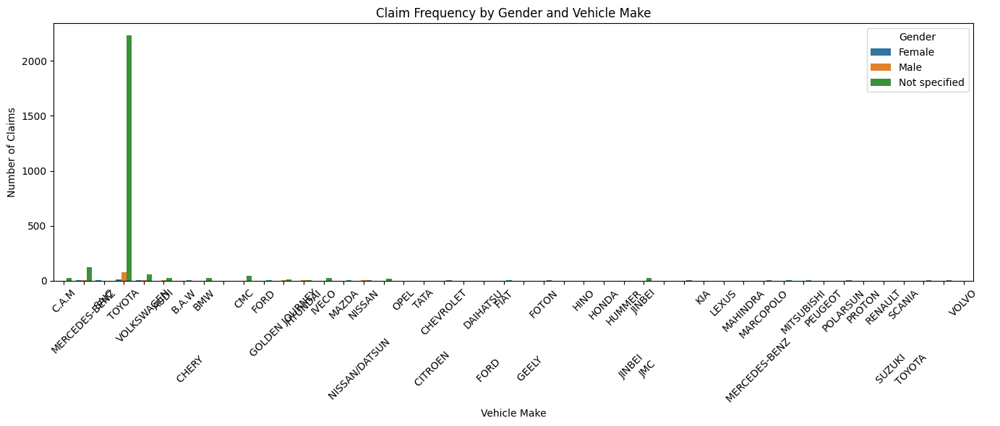

In [108]:
plt.figure(figsize=(14,6))

freq_gender_make = (
    df_clean.groupby(['Gender', 'make'])['has_claim']
    .sum()     # assuming HasClaim = 1 if claim happened
    .reset_index()
)

sns.barplot(
    data=freq_gender_make,
    x='make',
    y='has_claim',
    hue='Gender'
)

plt.xticks(rotation=45)
plt.title('Claim Frequency by Gender and Vehicle Make')
plt.xlabel('Vehicle Make')
plt.ylabel('Number of Claims')
plt.tight_layout()
plt.show()


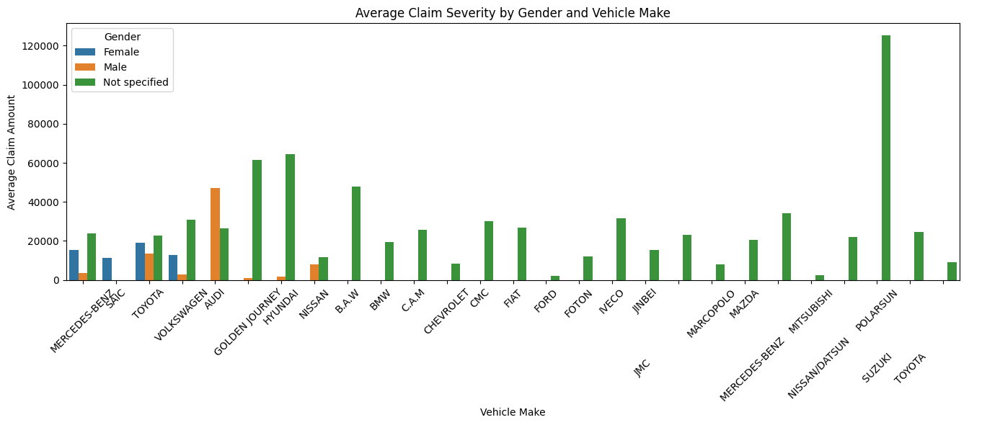

In [109]:
plt.figure(figsize=(14,6))

severity = (
    df_clean[df_clean['TotalClaims'] > 0]
    .groupby(['Gender', 'make'])['TotalClaims']
    .mean()
    .reset_index()
)

sns.barplot(
    data=severity,
    x='make',
    y='TotalClaims',
    hue='Gender'
)

plt.xticks(rotation=45)
plt.title('Average Claim Severity by Gender and Vehicle Make')
plt.xlabel('Vehicle Make')
plt.ylabel('Average Claim Amount')
plt.tight_layout()
plt.show()


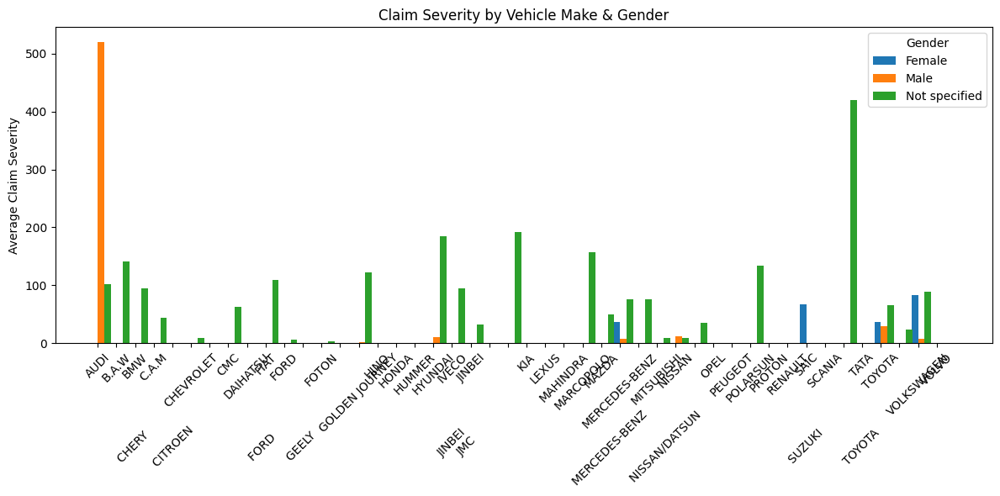

In [10]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# --- Compute Claim Severity ---
severity = (
    df.groupby(["make", "Gender"])["TotalClaims"]
    .mean()
    .unstack()  # Gender becomes columns
)

# --- Plot ---
plt.figure(figsize=(12, 6))

x = np.arange(len(severity.index))  # vehicle makes
width = 0.35  # bar width

# Bars for each gender
for i, gender in enumerate(severity.columns):
    plt.bar(x + i * width, severity[gender], width, label=gender)

plt.xticks(x + width / 2, severity.index, rotation=45)
plt.ylabel("Average Claim Severity")
plt.title("Claim Severity by Vehicle Make & Gender")
plt.legend(title="Gender")

plt.tight_layout()
plt.show()


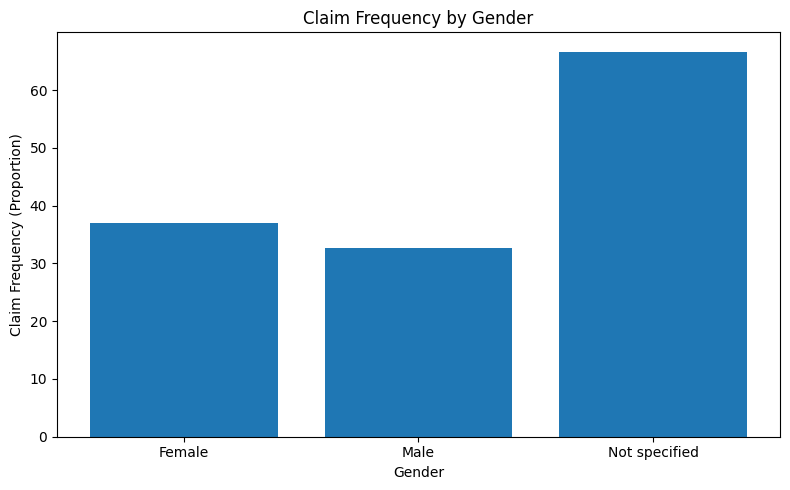

In [8]:
import pandas as pd
import matplotlib.pyplot as plt

# Calculate claim frequency by gender
claim_frequency = df.groupby("Gender")["TotalClaims"].mean()

# Plot
plt.figure(figsize=(8, 5))
plt.bar(claim_frequency.index, claim_frequency.values)

plt.title("Claim Frequency by Gender")
plt.xlabel("Gender")
plt.ylabel("Claim Frequency (Proportion)")
plt.xticks(rotation=0)

plt.tight_layout()
plt.show()


c:\Users\hp\Pictures\AlphaCare Insurance Solutions (ACIS)\alpha-care-risk-analytics\.week3\Lib\site-packages\matplotlib\transforms.py:2437: RuntimeWarning: invalid value encountered in dot
  return Affine2D(np.dot(self._b.get_affine().get_matrix(),


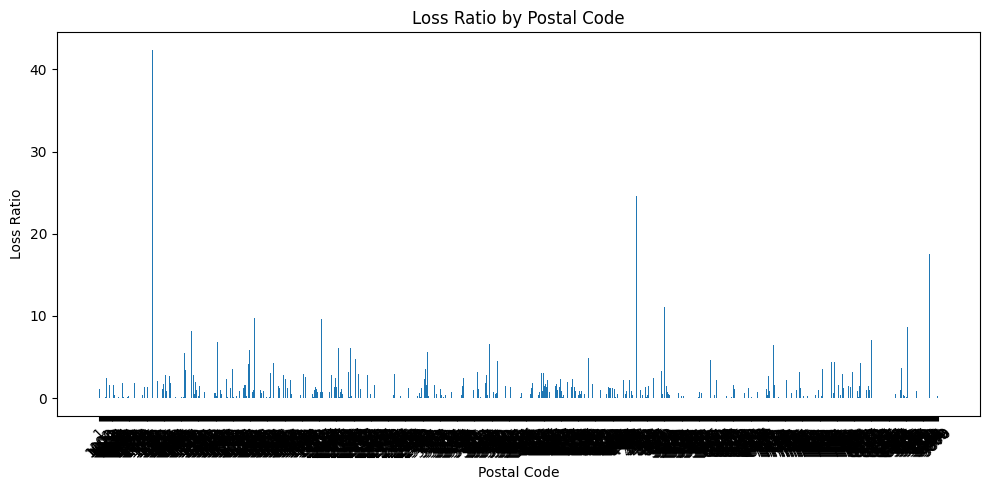

In [9]:
import pandas as pd
import matplotlib.pyplot as plt

# --- Calculate Loss Ratio ---
# Loss Ratio = Total Claims Cost / Total Premium per Postal Code
loss_ratio = (
    df.groupby("PostalCode")[["TotalClaims", "TotalPremium"]]
    .sum()
    .assign(LossRatio=lambda x: x["TotalClaims"] / x["TotalPremium"])
)

# --- Plot Bar Chart ---
plt.figure(figsize=(10, 5))
plt.bar(loss_ratio.index, loss_ratio["LossRatio"])

plt.title("Loss Ratio by Postal Code")
plt.xlabel("Postal Code")
plt.ylabel("Loss Ratio")
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


In [111]:
top_makes = (
    df_clean['make'].value_counts()
    .head(10)
    .index
)

df_top = df_clean[df_clean['make'].isin(top_makes)]


# Insurance Risk & Profitability Analysis Report

## 1. Overview

This analysis examines claim frequency, claim severity, and profitability variation across key segments of an insurance portfolio. Statistical hypothesis tests, descriptive summaries, and visual exploration were used to evaluate whether risk differs by province, postal code, gender, and vehicle characteristics.

### Portfolio-level Metrics
- **Overall Claim Frequency:** 0.00279  
- **Overall Average Severity (conditional on claim):** 23,273.39  
- **Overall Margin (sum):** –2,955,983  

The negative portfolio-level margin indicates **underpricing relative to realized losses**.

---

## 2. Provincial Risk Differences (H0₁)

**Null hypothesis:** No difference in risk (frequency or severity) across provinces.  
**Result:** Rejected for both frequency and severity.

### 2.1 Claim Frequency by Province
Highest frequency:
- Gauteng (~0.00336)
- KwaZulu-Natal (~0.00285)
- Limpopo & North West (~0.00243–0.00270)

Lowest frequency:
- Northern Cape (~0.00125)
- Free State (~0.00136)

**Interpretation:** More urbanized regions (Gauteng, KZN) show higher exposure to accidents and theft.

### 2.2 Claim Severity by Province
Highest severities:
- Free State (~32,266)
- KwaZulu-Natal (~29,609)
- Western & Eastern Cape (~27–28k)

Lowest severities:
- Northern Cape (~11,186)
- Limpopo (~15,171)

**Interpretation:** Severity differences suggest regional variation in repair costs, labour pricing, and accident types.

### 2.3 Statistical Tests
- **Chi-square frequency:** χ² = 104.19, p < 0.000001 → Reject H0  
- **Kruskal-Wallis severity:** H = 105.749, p < 0.000001 → Reject H0  
- **Pairwise Mann-Whitney (Bonferroni):** Multiple significant differences  

**Conclusion:** Provinces differ significantly in both frequency and severity → province should be included as a rating factor.

---

## 3. Zip/Postal Code Risk Differences (H0₂)

**Null hypothesis:** Claim frequency and margins do not differ across postal codes.  
**Result:** Rejected.

### 3.1 Frequency Variation
- **Chi-square (postal codes ≥ 50 policies):**  
  χ² = 1427.616, p < 0.000001 → Strong evidence of postal-level variation.

### 3.2 Margin Variation
- **Kruskal-Wallis:**  
  H = 88,162.236, p < 0.000001 → Significant profitability differences.

### 3.3 Tukey HSD
- Tukey was attempted but sample sizes were too small or too many groups.
- Pairwise Kruskal-Wallis used instead.

**Interpretation:** Postal code is a powerful predictor of geographical insurance risk. Some areas may be severely underpriced.

---

## 4. Gender Risk Differences (H0₄)

**Null hypothesis:** No risk difference between male and female policyholders.  
**Result:** Fail to reject for both frequency and severity.

### 4.1 Gender Counts
- Not specified: 940,990  
- Male: 42,817  
- Female: 6,755  

This is a highly imbalanced distribution.

### 4.2 Statistical Tests
- **Chi-square frequency:** χ² = 0.004, p = 0.951 → No difference  
- **Mann-Whitney severity:** p = 0.223 → No difference  

**Interpretation:**  
There is no statistically meaningful evidence that gender impacts claim risk. The “not specified” category dominates and may obscure minor patterns.

---

## 5. Claim Severity by Vehicle Make & Gender

Key findings:
- Severity varies strongly across vehicle makes.
- Some makes (e.g., **POLARSUN**) show extremely high severity due to small samples or costly individual claims.
- Gender differences are minimal and not actionable.

**Conclusion:** Vehicle make impacts severity; gender does not.

---

## 6. A/B Segmentation & Balance Assessment

### A/B Groups (example: vehicle make split)
- **Group A:** 186,818  
- **Group B:** 813,280  

### Balance (Standardized Mean Difference — SMD)
- SMD (custom variable): –0.001  
- SMD (claim frequency): –0.006  

Values < 0.1 indicate excellent balance.

### A/B Risk Comparison
- **Proportion z-test (frequency):**  
  z = 2.472, p = 0.013 → Groups differ in frequency  

- **Mann-Whitney (severity):**  
  p = 0.216 → No difference detected  

- **Bootstrap severity difference (mean):**  
  Difference = –5,664 (B − A)  
  95% CI = [–10,956, –1,007]  

Bootstrap indicates severity likely differs, even if Mann-Whitney was not sensitive enough.

**Conclusion:** Subtle but meaningful differences exist between Group A and Group B.

---

## 7. Portfolio Interpretation & Recommendations

### 7.1 Key Insights
- **Provinces:** Strong predictors of risk → must be in pricing.  
- **Postal codes:** Even stronger variation → identify underpriced pockets.  
- **Gender:** No predictive power → unnecessary rating variable.  
- **Vehicle make:** Large severity differences → pricing factor required.  
- **Negative overall margin:** Portfolio is underpriced.

---

## 8. Recommendations

### Pricing
- Apply granular province and postal code adjustments.
- Review vehicle make relativities and adjust outlier makes.

### Underwriting
- Investigate high-loss postal codes for crime patterns or fraud.
- Review low-frequency/high-severity provinces for catastrophe exposure.

### Operations & Reporting
- Rebalance portfolio to reduce exposure in high-risk regions.
- Improve data completeness (gender, vehicle details).

---

## 9. Final Conclusion

The dataset shows strong statistical evidence of geographical and vehicle-related segmentation. These factors materially contribute to the negative overall portfolio margin. In contrast, gender does not meaningfully influence claim behaviour.

Implementing geographically-aware pricing models and updating vehicle make loadings will significantly improve underwriting profitability.

